importing library

In [ ]:
import os
import random
import numpy as np
import glob as glob
import matplotlib.pyplot as plt
import cv2
import requests
import random

In [ ]:
# Mount Google Drive
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


I uploaded a zip folder in my drive which contain the dataset, so i need to unzip this folder using the script below

In [ ]:
os.chdir('/content/drive/MyDrive/Tunisian_Road_Sign')

In [ ]:
import zipfile
with zipfile.ZipFile('Road signs and Traffic lights dataset.v1i.yolov5pytorch.zip', 'r') as zip_ref:
    zip_ref.extractall('/content/drive/MyDrive/Tunisian_Road_Sign')

now as my dataset is uploaded, we will visualize some of images to assure that my dataset is ready.

In [ ]:
base_folder = '/content/drive/MyDrive/Tunisian_Road_Sign'
train_images=os.path.join(base_folder, "train","images")
train_labels = os.path.join(base_folder, "train", "labels")
valid_images=os.path.join(base_folder, "valid","images")
valid_labels = os.path.join(base_folder, "valid", "labels")
test_images=os.path.join(base_folder, "test","images")
test_labels = os.path.join(base_folder, "test", "labels")

In [ ]:
class_names=['Bend_to_left', 'Bend_to_right', 'Double_bend_left', 'Double_bend_right', 'Fork_road', 'Narrow_road', 'No_entry', 'No_left_turn', 'No_right_turn', 'No_u_turn', 'Speed_limit_100km', 'Speed_limit_110km', 'Speed_limit_120km', 'Speed_limit_30km', 'Speed_limit_40km', 'Speed_limit_50km', 'Speed_limit_60km', 'Speed_limit_70km', 'Speed_limit_80km', 'Speed_limit_90km', 'Traffic_light_green', 'Traffic_light_red', 'car', 'motorcycle', 'person']
colors = np.random.uniform(0, 255, size=(len(class_names), 3))
print(class_names[5])

Narrow_road


In [ ]:
  def yolo2bbox(bboxes):
    xmin, ymin = bboxes[0]-bboxes[2]/2, bboxes[1]-bboxes[3]/2
    xmax, ymax = bboxes[0]+bboxes[2]/2, bboxes[1]+bboxes[3]/2
    return xmin, ymin, xmax, ymax

In [ ]:
def plot_box(image, bboxes, labels):
    # Need the image height and width to denormalize
    # the bounding box coordinates
    h, w, _ = image.shape
    for box_num, box in enumerate(bboxes):
        x1, y1, x2, y2 = yolo2bbox(box)
        # denormalize the coordinates
        xmin = int(x1*w)
        ymin = int(y1*h)
        xmax = int(x2*w)
        ymax = int(y2*h)
        width = xmax - xmin
        height = ymax - ymin

        class_name = class_names[int(labels[box_num])-1]

        cv2.rectangle(
            image,
            (xmin, ymin), (xmax, ymax),
            color=colors[class_names.index(class_name)],
            thickness=2
        )

        font_scale = min(1,max(3,int(w/500)))
        font_thickness = min(2, max(10,int(w/50)))

        p1, p2 = (int(xmin), int(ymin)), (int(xmax), int(ymax))
        # Text width and height
        tw, th = cv2.getTextSize(
            class_name,
            0, fontScale=font_scale, thickness=font_thickness
        )[0]
        p2 = p1[0] + tw, p1[1] + -th - 10
        cv2.rectangle(
            image,
            p1, p2,
            color=colors[class_names.index(class_name)],
            thickness=-1,
        )
        cv2.putText(
            image,
            class_name,
            (xmin+1, ymin-10),
            cv2.FONT_HERSHEY_SIMPLEX,
            font_scale,
            (255, 255, 255),
            font_thickness
        )
    return image

In [ ]:
def plot(image_paths, label_paths, num_samples):
    all_training_images = glob.glob(image_paths)
    all_training_labels = glob.glob(label_paths)
    all_training_images.sort()
    all_training_labels.sort()

    # Print the list of image files
    print("Image files:", all_training_images)
    # Print the list of label files
    print("Label files:", all_training_labels)

    num_images = len(all_training_images)

    plt.figure(figsize=(15, 12))
    for i in range(num_samples):
        j = random.randint(0, num_images - 1)
        image = cv2.imread(all_training_images[j])
        print(f"Processing image file: {all_training_images[j]}")  # Debug line
        with open(all_training_labels[j], 'r') as f:
            bboxes = []
            labels = []
            label_lines = f.readlines()
            for label_line in label_lines:
                parts = label_line.split(' ')
                label = parts[0]
                bbox_string = ' '.join(parts[1:])
                x_c, y_c, w, h = bbox_string.split(' ')
                x_c = float(x_c)
                y_c = float(y_c)
                w = float(w)
                h = float(h)
                bboxes.append([x_c, y_c, w, h])
                labels.append(label)
            print(f"For image file: {all_training_images[j]}, labels are: {labels} and bounding boxes are: {bboxes}")  # Debug line
        result_image = plot_box(image, bboxes, [str(int(label) + 1) for label in labels])
        plt.subplot(2, 2, i + 1)
        plt.imshow(result_image[:, :, ::-1])
        plt.axis('off')
    plt.subplots_adjust(wspace=0)
    plt.tight_layout()
    plt.show()


In [ ]:
!ls

 data.yaml	      README.roboflow.txt					     test    valid
 README.dataset.txt  'Road signs and Traffic lights dataset.v1i.yolov5pytorch.zip'   train


Image files: ['/content/drive/MyDrive/Tunisian_Road_Sign/train/images/000000_jpg.rf.f5cdeb1d42af45544aab1ea09ef16f06.jpg', '/content/drive/MyDrive/Tunisian_Road_Sign/train/images/000001_jpg.rf.b172f9997bfb7e4933a72e5ae7bc638a.jpg', '/content/drive/MyDrive/Tunisian_Road_Sign/train/images/000002_jpg.rf.cc12984f32a003d5b4827b7e926ddadb.jpg', '/content/drive/MyDrive/Tunisian_Road_Sign/train/images/000003_jpg.rf.d0a5361e02d99f09cdfa1bc45c8f6e70.jpg', '/content/drive/MyDrive/Tunisian_Road_Sign/train/images/000007_jpg.rf.4bc4963813e678d88ed69f84edf1714d.jpg', '/content/drive/MyDrive/Tunisian_Road_Sign/train/images/000010_jpg.rf.6dc7dbb384bc2ccc4a085b4d4dfc56cd.jpg', '/content/drive/MyDrive/Tunisian_Road_Sign/train/images/000011_jpg.rf.d3233d74ad176d5aaa6b556aa7e37211.jpg', '/content/drive/MyDrive/Tunisian_Road_Sign/train/images/000013_jpg.rf.955791308cb04ce3d8143327482bad40.jpg', '/content/drive/MyDrive/Tunisian_Road_Sign/train/images/000014_jpg.rf.eceb83c2bbcc8564a48f37f8c44e69ed.jpg', '/con

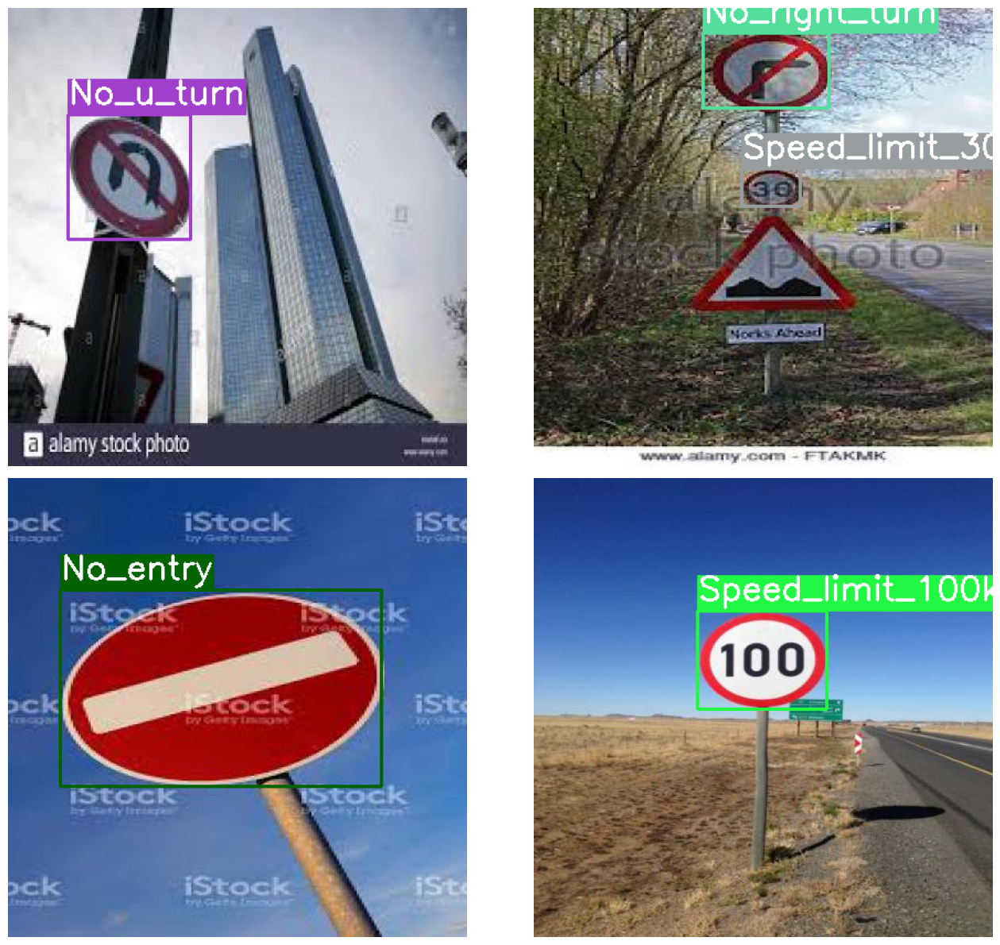

In [ ]:
# Visualize a few training images.
plot(
    image_paths='/content/drive/MyDrive/Tunisian_Road_Sign/train/images/*',
    label_paths='/content/drive/MyDrive/Tunisian_Road_Sign/train/labels/*',
    num_samples=4,
)

as we see the dataset is already good, so we validate the data.  :)

##Setting up helper functions

In [ ]:
def set_res_dir():
    # Directory to store results
    res_dir_count = len(glob.glob('runs/train/*'))
    print(f"Current number of result directories: {res_dir_count}")
    if TRAIN:
        RES_DIR = f"results_{res_dir_count+1}"
        print(RES_DIR)
    else:
        RES_DIR = f"results_{res_dir_count}"
    return RES_DIR

In [ ]:
def monitor_tensorboard():
    %load_ext tensorboard
    %tensorboard --logdir 'runs/train'

In [ ]:
!git clone https://github.com/ultralytics/yolov5.git

Cloning into 'yolov5'...
remote: Enumerating objects: 16057, done.
remote: Total 16057 (delta 0), reused 0 (delta 0), pack-reused 16057
Receiving objects: 100% (16057/16057), 14.66 MiB | 14.70 MiB/s, done.
Resolving deltas: 100% (11028/11028), done.


In [ ]:
!ls

 data.yaml	      README.roboflow.txt					     test    valid
 README.dataset.txt  'Road signs and Traffic lights dataset.v1i.yolov5pytorch.zip'   train   yolov5


In [ ]:
%cd yolov5

/content/drive/MyDrive/Tunisian_Road_Sign/yolov5


In [ ]:
!ls

benchmarks.py	 data	     LICENSE	      requirements.txt	tutorial.ipynb
CITATION.cff	 detect.py   models	      segment		utils
classify	 export.py   README.md	      setup.cfg		val.py
CONTRIBUTING.md  hubconf.py  README.zh-CN.md  train.py


In [ ]:
!pip install -r requirements.txt

##Training

In [ ]:
monitor_tensorboard()

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 16614), started 0:56:38 ago. (Use '!kill 16614' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
TRAIN = True
# Number of epochs to train for.
EPOCHS = 50

In [ ]:
RES_DIR = set_res_dir()
if TRAIN:
    !python train.py --data '/content/drive/MyDrive/Tunisian_Road_Sign/data.yaml' --weights yolov5s.pt \
    --img 640 --epochs {EPOCHS} --batch-size 16 --name {RES_DIR}

Current number of result directories: 0
results_1
2023-11-12 11:13:33.641745: E tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:9342] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2023-11-12 11:13:33.641800: E tensorflow/compiler/xla/stream_executor/cuda/cuda_fft.cc:609] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2023-11-12 11:13:33.641841: E tensorflow/compiler/xla/stream_executor/cuda/cuda_blas.cc:1518] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
train: weights=yolov5s.pt, cfg=, data=/content/drive/MyDrive/Tunisian_Road_Sign/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=50, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, devic

## Check Out the Validation Predictions and Inference

In this section, we will check out the predictions of the validation images saved during training. Along with that, we will also check out inference of images and videos.

### Visualization and Inference Utilities

In [ ]:
# Function to show validation predictions saved during training.
def show_valid_results(RES_DIR):
    !ls runs/train/{RES_DIR}
    EXP_PATH = f"runs/train/{RES_DIR}"
    validation_pred_images = glob.glob(f"{EXP_PATH}/*_pred.jpg")
    print(validation_pred_images)
    for pred_image in validation_pred_images:
        image = cv2.imread(pred_image)
        plt.figure(figsize=(19, 16))
        plt.imshow(image[:, :, ::-1])
        plt.axis('off')
        plt.show()

In [ ]:
# Helper function for inference on images.
def inference(RES_DIR, data_path):
    # Directory to store inference results.
    infer_dir_count = len(glob.glob('runs/detect/*'))
    print(f"Current number of inference detection directories: {infer_dir_count}")
    INFER_DIR = f"inference_{infer_dir_count+1}"
    print(INFER_DIR)
    # Inference on images.
    !python detect.py --weights runs/train/{RES_DIR}/weights/best.pt \
    --source {data_path} --name {INFER_DIR}
    return INFER_DIR

In [ ]:
def visualize(INFER_DIR):
# Visualize inference images.
    INFER_PATH = f"runs/detect/{INFER_DIR}"
    infer_images = glob.glob(f"{INFER_PATH}/*.jpg")
    print(infer_images)
    for pred_image in infer_images:
        image = cv2.imread(pred_image)
        plt.figure(figsize=(19, 16))
        plt.imshow(image[:, :, ::-1])
        plt.axis('off')
        plt.show()

confusion_matrix.png				     PR_curve.png	    val_batch0_pred.jpg
events.out.tfevents.1699787617.052d5a778be2.31781.0  R_curve.png	    val_batch1_labels.jpg
F1_curve.png					     results.csv	    val_batch1_pred.jpg
hyp.yaml					     results.png	    val_batch2_labels.jpg
labels_correlogram.jpg				     train_batch0.jpg	    val_batch2_pred.jpg
labels.jpg					     train_batch1.jpg	    weights
opt.yaml					     train_batch2.jpg
P_curve.png					     val_batch0_labels.jpg
['runs/train/results_1/val_batch0_pred.jpg', 'runs/train/results_1/val_batch1_pred.jpg', 'runs/train/results_1/val_batch2_pred.jpg']


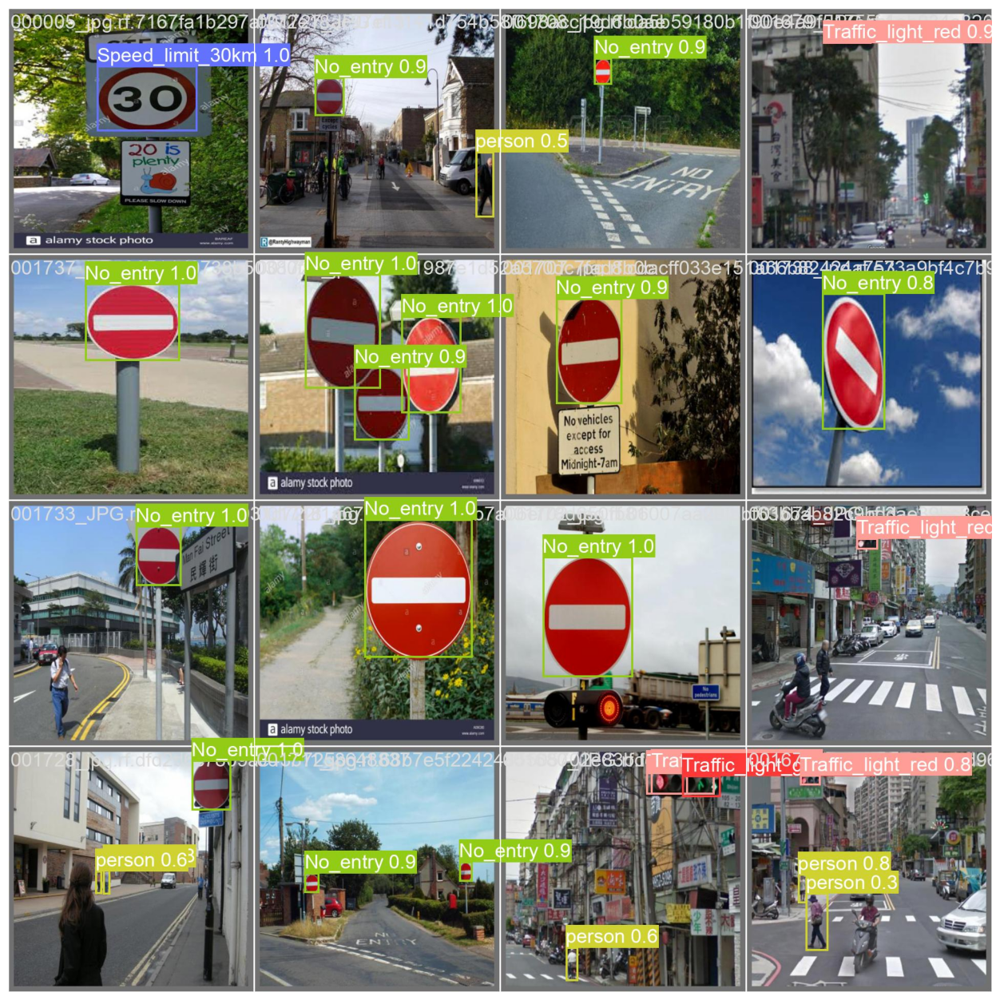

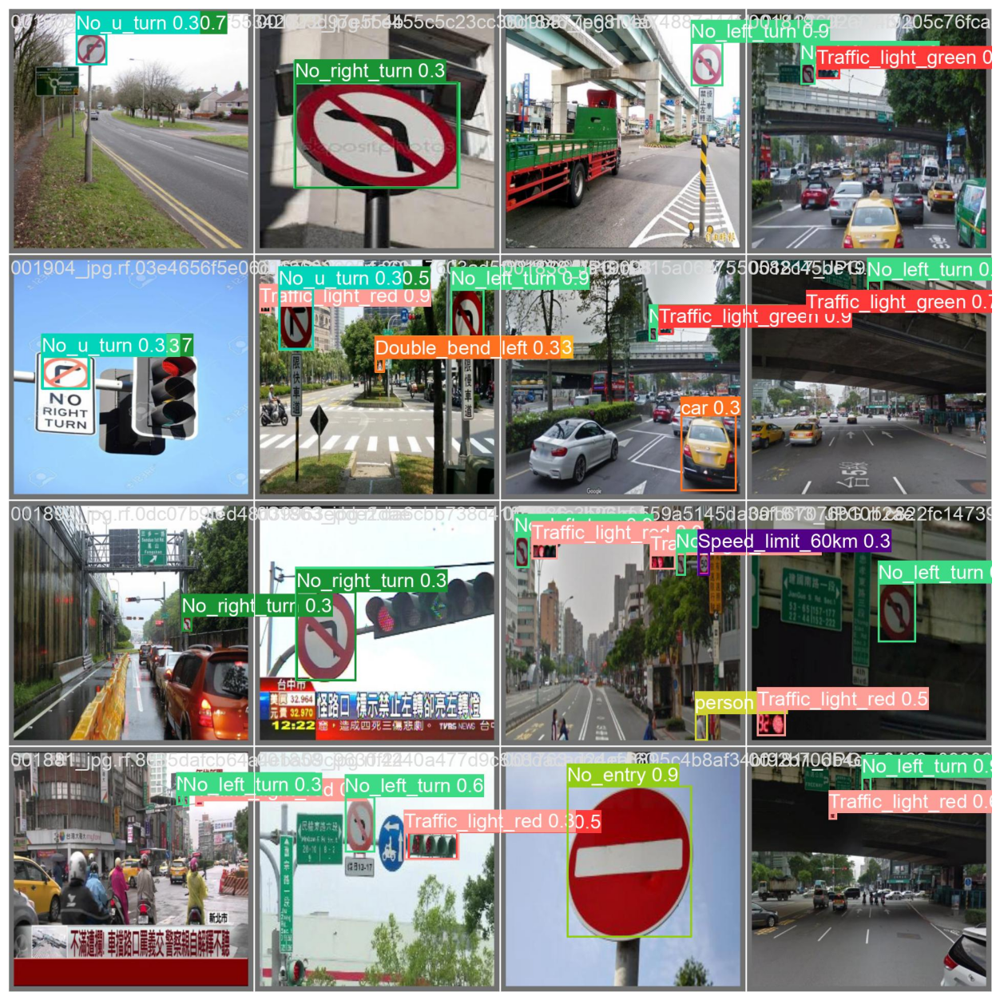

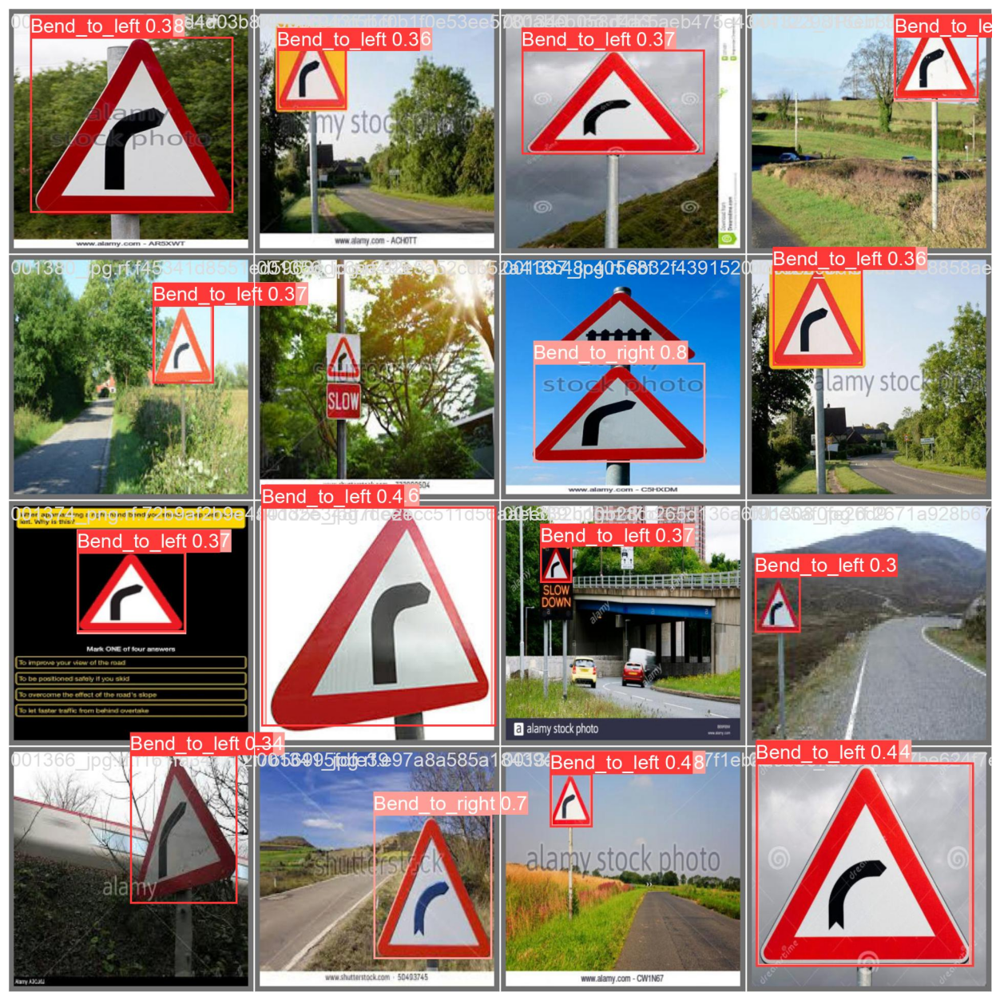

In [ ]:
show_valid_results(RES_DIR)

In [ ]:
# Inference on images.
IMAGE_INFER_DIR = inference(RES_DIR, '/content/drive/MyDrive/Tunisian_Road_Sign/test/images')

Current number of inference detection directories: 0
inference_1
detect: weights=['runs/train/results_1/weights/best.pt'], source=/content/drive/MyDrive/Tunisian_Road_Sign/test/images, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=inference_1, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-240-g84ec8b5 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 157 layers, 7077550 parameters, 0 gradients, 16.0 GFLOPs
image 1/241 /content/drive/MyDrive/Tunisian_Road_Sign/test/images/000004_jpg.rf.9b908cec2bc4c2795bb0e3e67c119ec3.jpg: 640x640 1 Speed_limit_30km, 11.7ms
image 2/241 /content/drive/MyDrive/Tunisian_Road_Sign/test/image

['runs/detect/inference_1/000004_jpg.rf.9b908cec2bc4c2795bb0e3e67c119ec3.jpg', 'runs/detect/inference_1/000017_jpg.rf.8bbe578f3950a0de00f0f4a5d01fd110.jpg', 'runs/detect/inference_1/000023_jpg.rf.06c5b08b014d0eb01b8df8cedfbd094d.jpg', 'runs/detect/inference_1/000047_jpg.rf.410784c2b0654399ee6ae143983b94ea.jpg', 'runs/detect/inference_1/000060_jpg.rf.0ce6d012f0a93e62d69bb7bbcfa65382.jpg', 'runs/detect/inference_1/000063_jpg.rf.aee5c5f769b44afff0f493dba94bca62.jpg', 'runs/detect/inference_1/000065_jpg.rf.8650798fbc4eff47a7827f43bd828ee1.jpg', 'runs/detect/inference_1/000069_jpg.rf.10d2e2303801af27845621c1318289f4.jpg', 'runs/detect/inference_1/000074_jpg.rf.cbdf1b5f34a8b83e01190f430f681ed0.jpg', 'runs/detect/inference_1/000089_jpg.rf.b1495f3393d63552cd25423571e37237.jpg', 'runs/detect/inference_1/000092_jpg.rf.58cd393b9d32e08b144f52d9146b6528.jpg', 'runs/detect/inference_1/000094_jpg.rf.e8be4151e646fd1fab146d6931f3cc5e.jpg', 'runs/detect/inference_1/000104_jpg.rf.67dac6b0063127f057c3691c

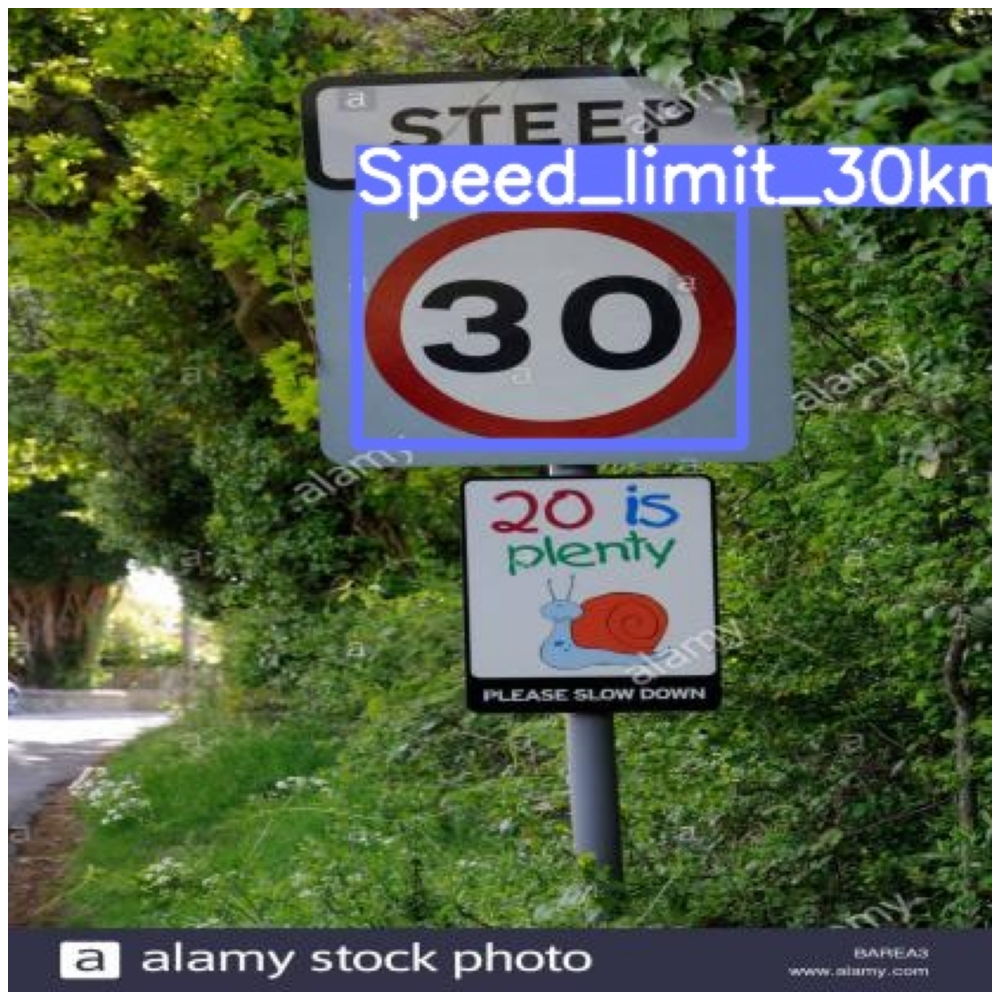

In [ ]:
visualize(IMAGE_INFER_DIR)

In [ ]:
%cd ..

/content/drive/MyDrive/Road_Sign_Detection/yolov5


In [ ]:
!ls

benchmarks.py	 data	     LICENSE	  README.zh-CN.md   setup.cfg	    val.py
CITATION.cff	 detect.py   models	  requirements.txt  train.py	    yolov5s.pt
classify	 export.py   __pycache__  runs		    tutorial.ipynb
CONTRIBUTING.md  hubconf.py  README.md	  segment	    utils


In [ ]:
%cd utils

/content/drive/MyDrive/Road_Sign_Detection/yolov5/utils


In [ ]:
!ls

activations.py	  aws		  downloads.py	     __init__.py  plots.py	  triton.py
augmentations.py  callbacks.py	  flask_rest_api     loggers	  __pycache__
autoanchor.py	  dataloaders.py  general.py	     loss.py	  segment
autobatch.py	  docker	  google_app_engine  metrics.py   torch_utils.py


In [ ]:
!python detect.py --weights 'runs/train/results_1/weights/best.pt' --img-size 640 --conf 0. --source '/content/drive/MyDrive/Road_Sign_Detection/50test.jpg'

detect: weights=['runs/train/results_1/weights/best.pt'], source=/content/drive/MyDrive/Road_Sign_Detection/50test.jpg, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.5, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-240-g84ec8b5 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 157 layers, 7088338 parameters, 0 gradients, 16.0 GFLOPs
image 1/1 /content/drive/MyDrive/Road_Sign_Detection/50test.jpg: 512x640 1 Stop_Sign, 68.6ms
Speed: 0.8ms pre-process, 68.6ms inference, 2.1ms NMS per image at shape (1, 3, 640, 640)
Results saved to runs/detect/exp6


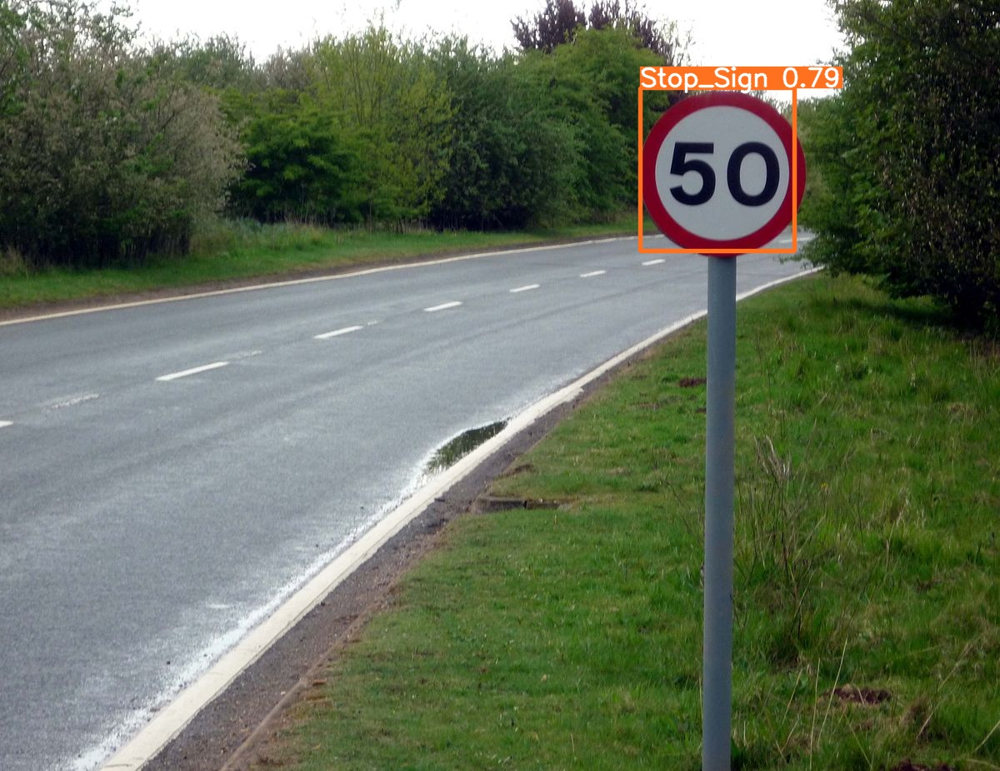

In [ ]:
from PIL import Image
from IPython.display import display

# Load the annotated image
image_path = 'runs/detect/exp6/50test.jpg'
image = Image.open(image_path)

# Display the image in the notebook
display(image)
